<a href="https://colab.research.google.com/github/Neeraj-Palliyali/CW/blob/master/Data_vizualization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# COMP1800 Data visualization : Coursework


ChrisCo is a fictional, but nonetheless very successful company managing a range of retail outlets across the
UK. ChrisCo collects a huge amount of data about individual customers visiting its outlets using its loyalty
card scheme but this customer data has been aggregated/averaged to give information about the company’s
45 outlets, each identified by a unique 3 letter code (e.g. ABC, XYZ, etc).

## Basic imports and installation



In [253]:
!pip install hvplot
# !pip install --upgrade hvplot panel bokeh ipykernel holoviews ipywidgets


import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import hvplot.pandas
import holoviews as hv
import matplotlib.pyplot as plt
import seaborn as sns
import panel as pn

pn.extension(comms='colab')
pd.options.mode.chained_assignment = None


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


### Data Import

In [254]:
main_data = pd.read_csv("https://tinyurl.com/ChrisCoDV/001284166/OutletDailyCustomers.csv", index_col = 0)
main_data.index = pd.to_datetime(main_data.index)
print('Printing the head data:')
print('_______________________')
main_data.head()

Printing the head data:
_______________________


,OTL,ZMY,YGE,ZSJ,HZQ,PFQ,QZF,DSA,OZW,XSB,...,YMQ,NFH,BMF,AGN,IFI,FZI,DZZ,MTE,ZYT,DHJ
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-01,83,0,62,0,60,55,58,1004,65,0,...,0,78,820,0,80,59,73,64,51,100
2021-01-02,93,0,69,0,80,70,77,1118,107,0,...,0,86,877,0,87,76,41,60,69,79
2021-01-03,79,0,62,0,65,73,53,844,67,0,...,0,99,751,0,73,73,72,59,65,95
2021-01-04,78,0,65,0,58,57,79,1020,93,0,...,0,83,798,0,85,80,58,56,66,99
2021-01-05,72,0,71,0,72,76,62,1125,92,0,...,0,59,890,0,83,74,81,63,83,108


In [255]:
print('Printing the tail data:')
print('_______________________')
main_data.tail()

Printing the tail data:
_______________________


,OTL,ZMY,YGE,ZSJ,HZQ,PFQ,QZF,DSA,OZW,XSB,...,YMQ,NFH,BMF,AGN,IFI,FZI,DZZ,MTE,ZYT,DHJ
Date,,,,,,,,,,,,,,,,,,,,,
2021-12-27,124,87,0,136,70,64,80,990,71,66,...,83,94,885,169,60,74,53,65,0,86
2021-12-28,79,86,0,145,83,65,81,924,122,88,...,52,83,994,48,59,68,55,66,0,79
2021-12-29,75,87,0,43,74,58,72,1039,101,116,...,73,78,840,146,102,61,64,71,0,99
2021-12-30,102,102,0,39,64,81,85,817,73,114,...,88,100,996,92,90,53,76,60,0,113
2021-12-31,116,83,0,104,81,61,81,972,119,0,...,69,104,958,59,75,81,70,69,0,108


In [256]:
print('Getting the shape the data:')
print('____________________________')

main_data.shape

Getting the shape the data:
____________________________


(365, 45)

In [257]:
print('Getting the statistical information about the data:')
print('___________________________________________________')
print(main_data.describe())


Getting the statistical information about the data:
___________________________________________________
              OTL         ZMY         YGE         ZSJ         HZQ         PFQ  \
count  365.000000  365.000000  365.000000  365.000000  365.000000  365.000000   
mean    84.065753   11.616438   49.723288   24.298630   69.323288   67.986301   
std     13.979029   24.131297   29.289060   38.718569   11.523489   11.545292   
min     43.000000    0.000000    0.000000    0.000000   39.000000   34.000000   
25%     75.000000    0.000000    0.000000    0.000000   61.000000   60.000000   
50%     84.000000    0.000000   64.000000    0.000000   70.000000   69.000000   
75%     94.000000    0.000000   69.000000   42.000000   76.000000   75.000000   
max    124.000000  102.000000   82.000000  152.000000  100.000000  108.000000   

              QZF          DSA         OZW         XSB  ...         YMQ  \
count  365.000000   365.000000  365.000000  365.000000  ...  365.000000   
mean    72.76438

In [258]:
main_data.isna().sum()

OTL    0
ZMY    0
YGE    0
ZSJ    0
HZQ    0
PFQ    0
QZF    0
DSA    0
OZW    0
XSB    0
CNW    0
IZX    0
END    0
EYS    0
FTW    0
NLT    0
CTH    0
HNV    0
EHT    0
DTO    0
GFA    0
RAN    0
CGV    0
MZO    0
GNL    0
PLB    0
EEC    0
LTU    0
CYK    0
BSQ    0
RFY    0
DMN    0
LLK    0
AYD    0
HTF    0
YMQ    0
NFH    0
BMF    0
AGN    0
IFI    0
FZI    0
DZZ    0
MTE    0
ZYT    0
DHJ    0
dtype: int64

## Inferences from basic steps

- The dataset has 45 columns.
- The dataset has the infromation of a complete year ie 365 days.
- This data is regarding the visitors who visit a particular outlet on the various days from January 2021 to December 2021.
- From the statistical information there are outlets where the visitor are zero. 
- There are no null values in any cells.



## Exploring the data

Main dataset evaluation data containing the daily number of visitors to each outlet.

- url : [main_data](https://tinyurl.com/ChrisCoDV/001284166/OutletDailyCustomers.csv)

In [259]:
main_data = main_data.reindex(main_data.sum().sort_values(ascending = False).index, axis=1)  
# Sorting so as to get a better graph representation 

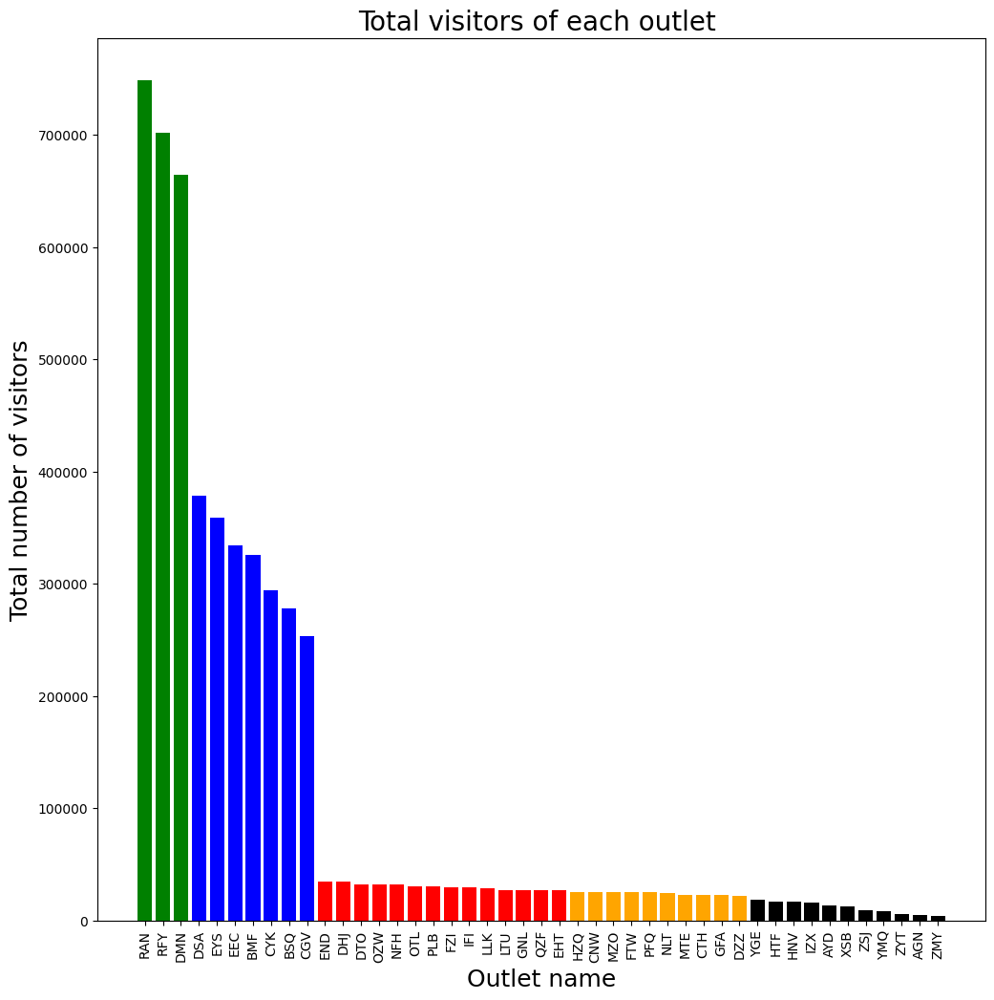

In [260]:
# Splitting for high, medium and low

categories = ['High', 'Medium', 'L1_Low', 'L2_Low', 'L3_Low']


high = []
medium = []
low = []
Level1 = []
Level2 = []
Level3 = []


colours = []
for name in main_data.columns:
    total_visits = main_data[name].sum()
    if total_visits > 400000:
        high.append(name)
        colour = 'green'
    elif total_visits > 100000:
        medium.append(name)
        colour = 'blue'
    elif total_visits > 26000:
        Level1.append(name)
        colour = 'red'
    elif total_visits > 19000:
        Level2.append(name)
        colour = 'orange'
    else:
        Level3.append(name)
        colour = 'black'

    colours.append(colour)

plt.figure(figsize=(12, 12))
x_pos = np.arange(len(main_data.columns))
plt.bar(x_pos, main_data.sum(), align='center', color=colours)
plt.xticks(x_pos, main_data.columns, rotation = 90)
plt.xlabel('Outlet name', fontsize=18)
plt.ylabel('Total number of visitors', fontsize=18)
plt.title('Total visitors of each outlet ', fontsize=20)
plt.show()




In [261]:
low = Level1+Level2+Level3
print('\nPrinting the High data:')
print('_______________________')
print(high)
print('\nPrinting the Medium data:')
print('_______________________')
print(medium)
print('\nPrinting the low data:')
print('_______________________')
print(low)
#hihgh line grAPH for all three
#moving avg  for three


Printing the High data:
_______________________
['RAN', 'RFY', 'DMN']

Printing the Medium data:
_______________________
['DSA', 'EYS', 'EEC', 'BMF', 'CYK', 'BSQ', 'CGV']

Printing the low data:
_______________________
['END', 'DHJ', 'DTO', 'OZW', 'NFH', 'OTL', 'PLB', 'FZI', 'IFI', 'LLK', 'LTU', 'GNL', 'QZF', 'EHT', 'HZQ', 'CNW', 'MZO', 'FTW', 'PFQ', 'NLT', 'MTE', 'CTH', 'GFA', 'DZZ', 'YGE', 'HTF', 'HNV', 'IZX', 'AYD', 'XSB', 'ZSJ', 'YMQ', 'ZYT', 'AGN', 'ZMY']


## Summary
- ['RAN', 'RFY', 'DMN'] are the three highest visitor stores
- ['DSA', 'EYS', 'EEC', 'BMF', 'CYK', 'BSQ', 'CGV'] has a medium number of visitors

## Low visitor outlet analysis 

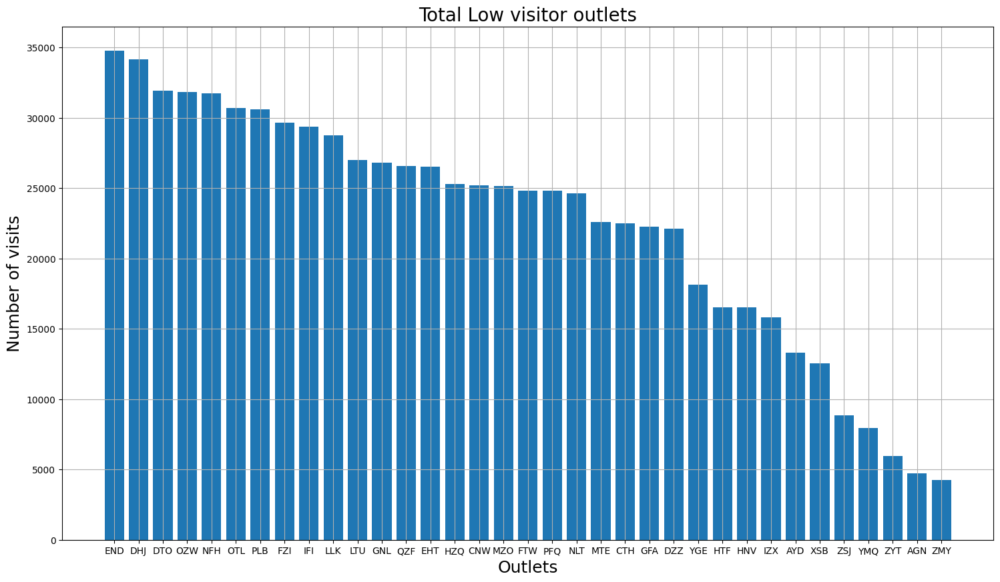

In [262]:
plt.figure(figsize=(18, 10))
x_pos = np.arange(len(main_data[low].columns))
plt.bar(x_pos, main_data[low].sum(), align="center")
plt.xticks(x_pos, main_data[low].columns)
plt.xlabel('Outlets', fontsize = 18)
plt.ylabel('Number of visits', fontsize = 18)
plt.title('Total Low visitor outlets', fontsize = 20)
plt.grid()
plt.show()

In [263]:
# Splitting the whole data into 3 subcategory, ie. High, Medium, Low



print('Outlets having low volume of visitors:',Level1)
print('Outlets having moderately-low volume of visitors:',Level2)
print('Outlets having extremely-low volume of visitors:',Level3)

Outlets having low volume of visitors: ['END', 'DHJ', 'DTO', 'OZW', 'NFH', 'OTL', 'PLB', 'FZI', 'IFI', 'LLK', 'LTU', 'GNL', 'QZF', 'EHT']
Outlets having moderately-low volume of visitors: ['HZQ', 'CNW', 'MZO', 'FTW', 'PFQ', 'NLT', 'MTE', 'CTH', 'GFA', 'DZZ']
Outlets having extremely-low volume of visitors: ['YGE', 'HTF', 'HNV', 'IZX', 'AYD', 'XSB', 'ZSJ', 'YMQ', 'ZYT', 'AGN', 'ZMY']


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
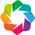

:NdLayout   [Variable]
   :Curve   [Date]   (value)

In [264]:

plot = main_data[Level1].hvplot.line(
    frame_height=200, frame_width=280,
    xlabel='Date', ylabel='No. of daily visitors',
    tools=['pan', 'box_zoom', 'wheel_zoom', 'undo', 'redo', 'hover', 'save', 'reset'],
    subplots=True
).cols(5)
hv.extension('bokeh')
plot

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
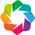

:NdLayout   [Variable]
   :Curve   [Date]   (value)

In [265]:
plot = main_data[Level2].hvplot.line(
    frame_height=200, frame_width=280,
    xlabel='Date', ylabel='No. of daily visitors',
    tools=['pan', 'box_zoom', 'wheel_zoom', 'undo', 'redo', 'hover', 'save', 'reset'],
    subplots=True
).cols(5)
hv.extension('bokeh')
plot

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
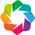

:NdLayout   [Variable]
   :Curve   [Date]   (value)

In [266]:
plot = main_data[Level3].hvplot.line(
    frame_height=200, frame_width=280,
    xlabel='Date', ylabel='No. of daily visitors',
    tools=['pan', 'box_zoom', 'wheel_zoom', 'undo', 'redo', 'hover', 'save', 'reset'],
    subplots=True
).cols(5)
hv.extension('bokeh')
plot

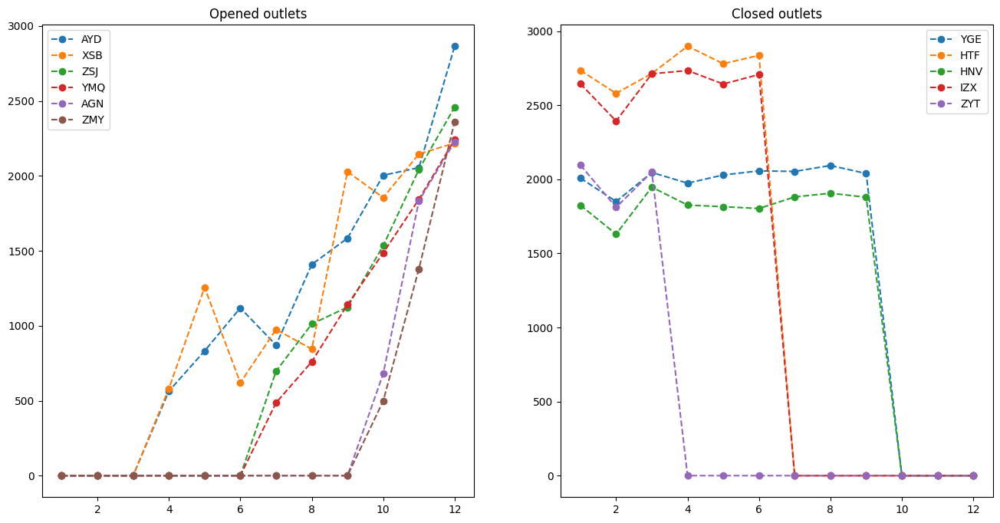

In [267]:
monthly_data = main_data.copy()
monthly_data['month'] = main_data.index.month
monthly_data = monthly_data.groupby('month').sum()
monthly_data
a = monthly_data.loc[:, (monthly_data == 0).any()]

ov = a.columns[(a == 0).iloc[0]]

opened = a[ov]

cv = a.columns[(a != 0).iloc[0]]

closed = a[cv]
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 8))

axes[0].plot(opened,'o--')

axes[1].plot(closed, 'o--')

axes[0].set_title('Opened outlets')

axes[1].set_title('Closed outlets')

axes[0].legend(opened.columns)

axes[1].legend(closed.columns)

plt.show()

## Summary 
After the analysis of the low visitor outlets the inference found are :
- Some outlets were not function can be due to ongoing works or something else but there are a few outlets that have zero visitors symbolising the outlet was not open

- Some outlests seem to start having visitors only after a specifc period can be due to the outlet only being open from those months

## Medium visitor outlet analysis

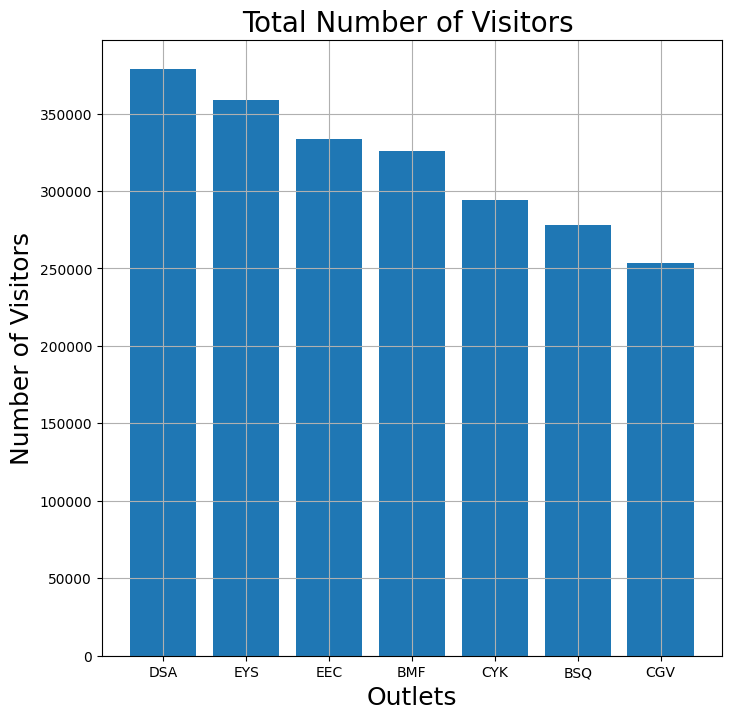

In [268]:
plt.figure(figsize=(8, 8))
x_pos = np.arange(len(main_data[medium].columns))
plt.bar(x_pos, main_data[medium].sum(), align='center')
plt.xticks(x_pos, main_data[medium].columns)
plt.xlabel('Outlets', fontsize=18)
plt.ylabel('Number of Visitors', fontsize=18)
plt.title('Total Number of Visitors ', fontsize=20)
plt.grid()
plt.show()

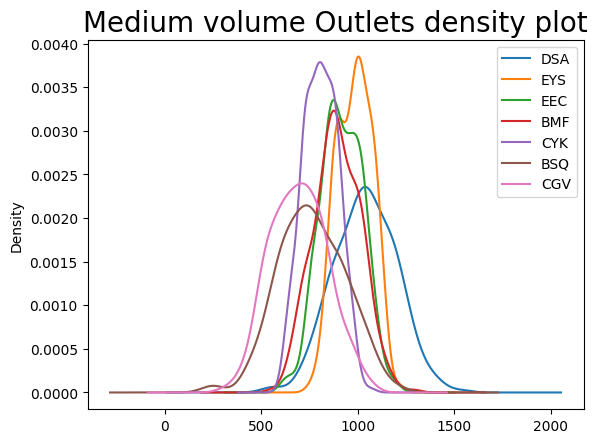

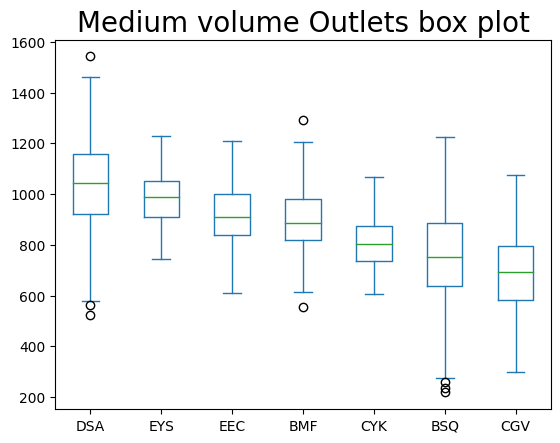

In [269]:
main_data[medium].plot.density()
plt.title("Medium volume Outlets density plot", fontsize = 20)
plt.show()
main_data[medium].plot.box()
plt.title("Medium volume Outlets box plot", fontsize = 20)
plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
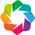

:NdOverlay   [Variable]
   :Curve   [Date]   (value)

In [270]:
plot = main_data[medium].hvplot.line(
    frame_height=250, frame_width=2000,
    xlabel='Date', ylabel='Number of visitors',
    title='Daily visitors', legend='top'
)
hv.extension('bokeh')
plot

- Medium generally has a visitors around 1000 people per day
- Highest value with DSA going to 1542 on 12-02-2021


## High visitor analysis

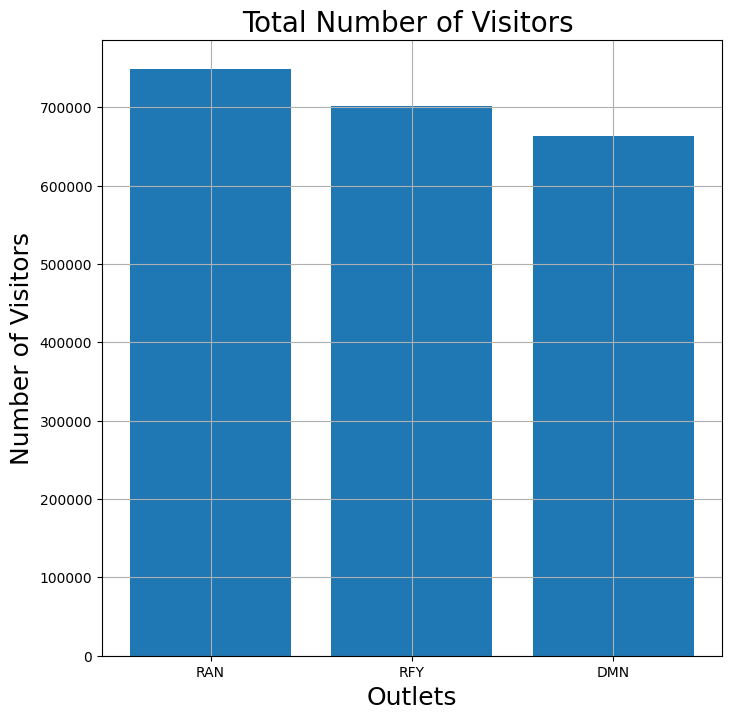

In [271]:
plt.figure(figsize=(8, 8))
x_pos = np.arange(len(main_data[high].columns))
plt.bar(x_pos, main_data[high].sum(), align='center')
plt.xticks(x_pos, main_data[high].columns)
plt.xlabel('Outlets', fontsize=18)
plt.ylabel('Number of Visitors', fontsize=18)
plt.title('Total Number of Visitors ', fontsize=20)
plt.grid()
plt.show()

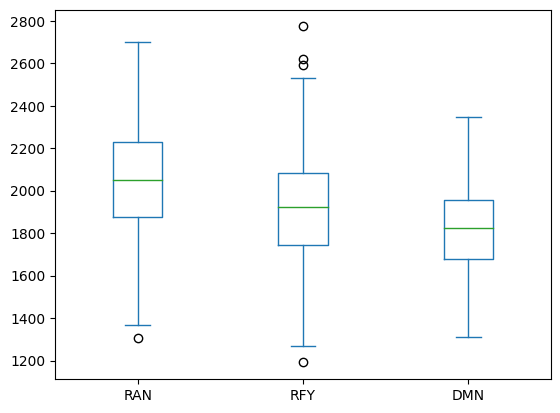

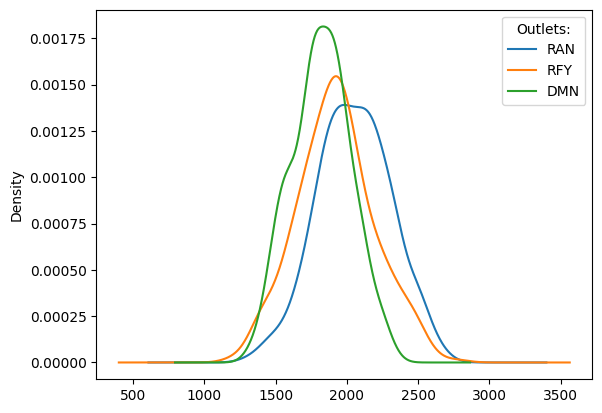

In [272]:
main_data[high].plot.box()
plt.show()
main_data[high].plot.density()
plt.legend(title = 'Outlets:')
plt.show()

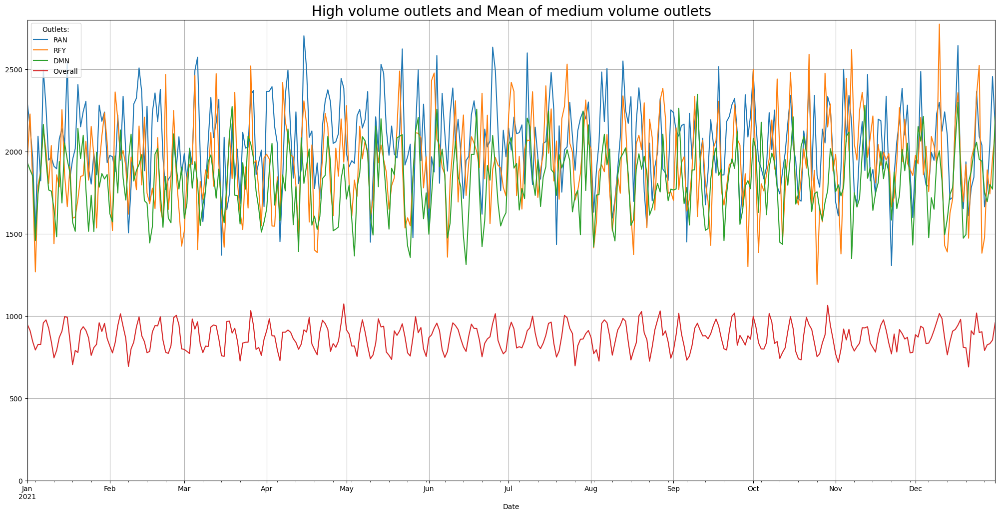

In [273]:
avg_data = main_data[high]
avg_data['Overall'] = main_data[medium].mean(axis=1)

avg_data.plot.line(figsize=(25,12))
plt.ylim((0.0, 2800) )
plt.grid()
plt.legend(title = 'Outlets:',loc = 2)
plt.title("High volume outlets and Mean of medium volume outlets", fontsize = 20)
plt.show()

- High visitor outlets outperform all mean of the all the medium performing outlets.




## Seasonal characteristics of medium volume outlets

<ipython-input-274-39e2229e2adb>:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')
<ipython-input-274-39e2229e2adb>:20: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')
<ipython-input-274-39e2229e2adb>:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45, ha='right')
<ipython-input-274-39e2229e2adb>:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[3].set_xticklabels(axes[3].get_xticklabels(), rotation=45, ha='right')


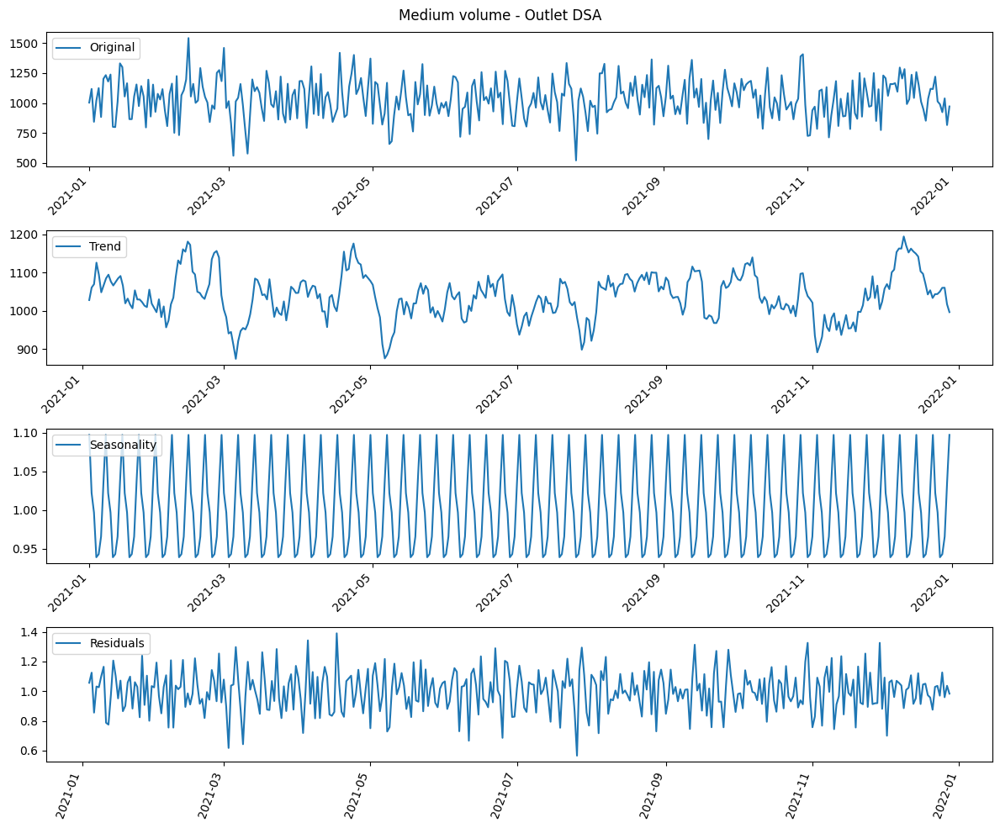

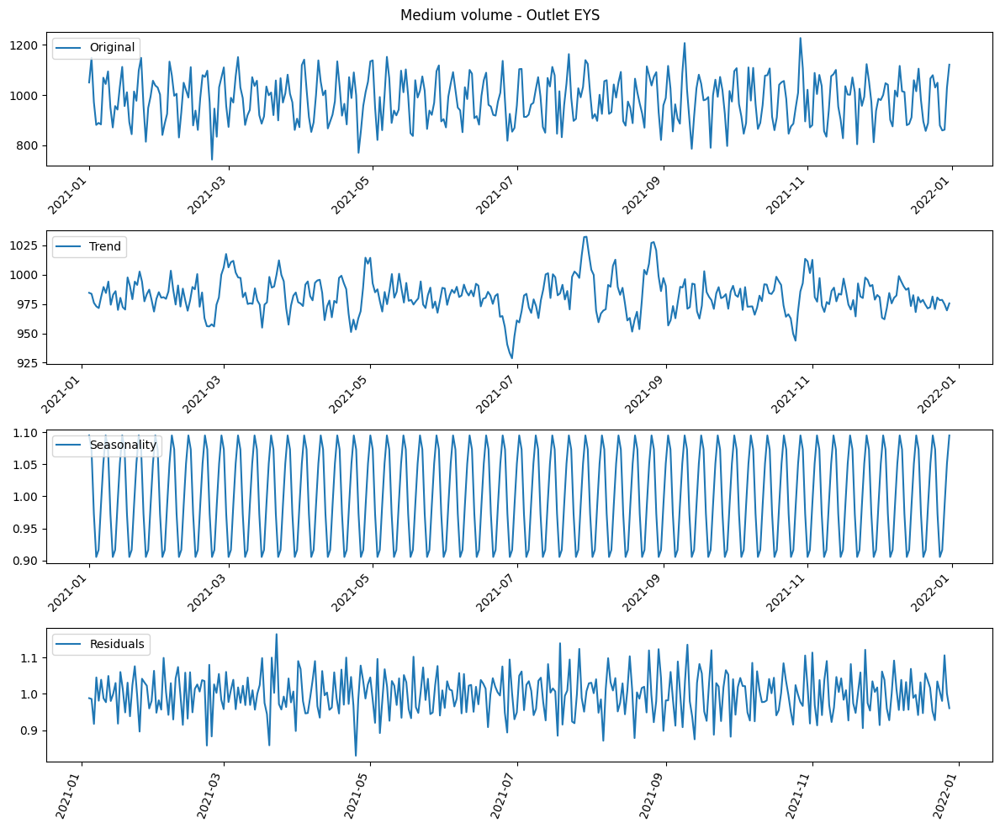

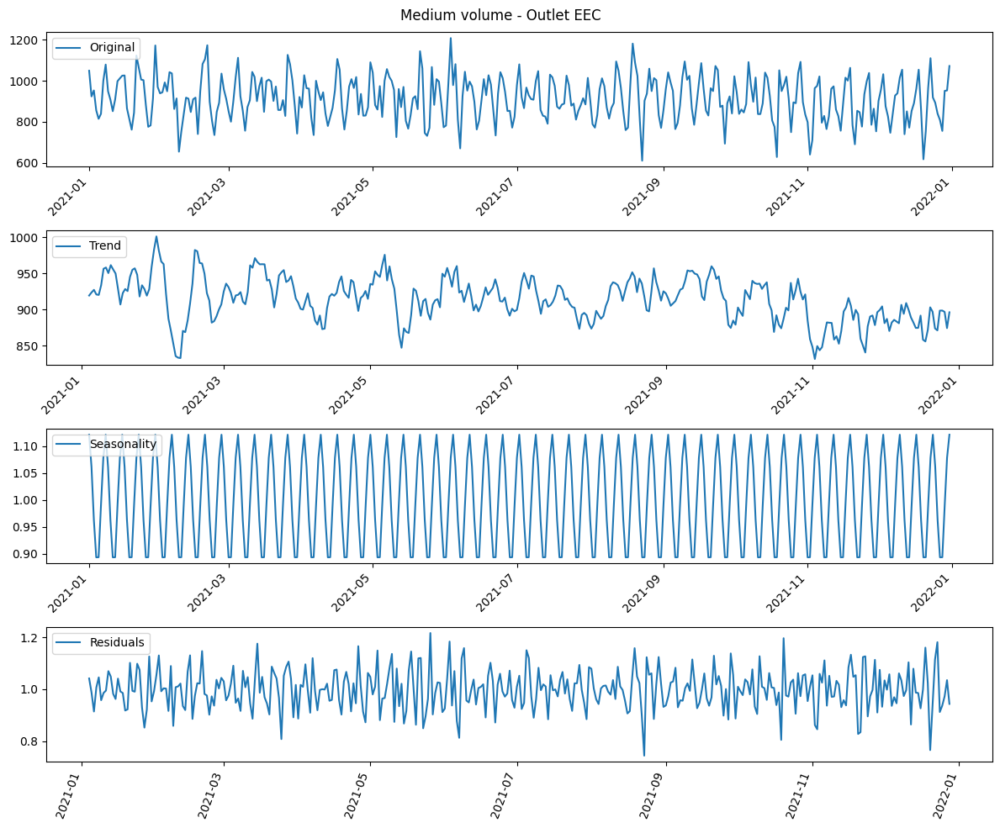

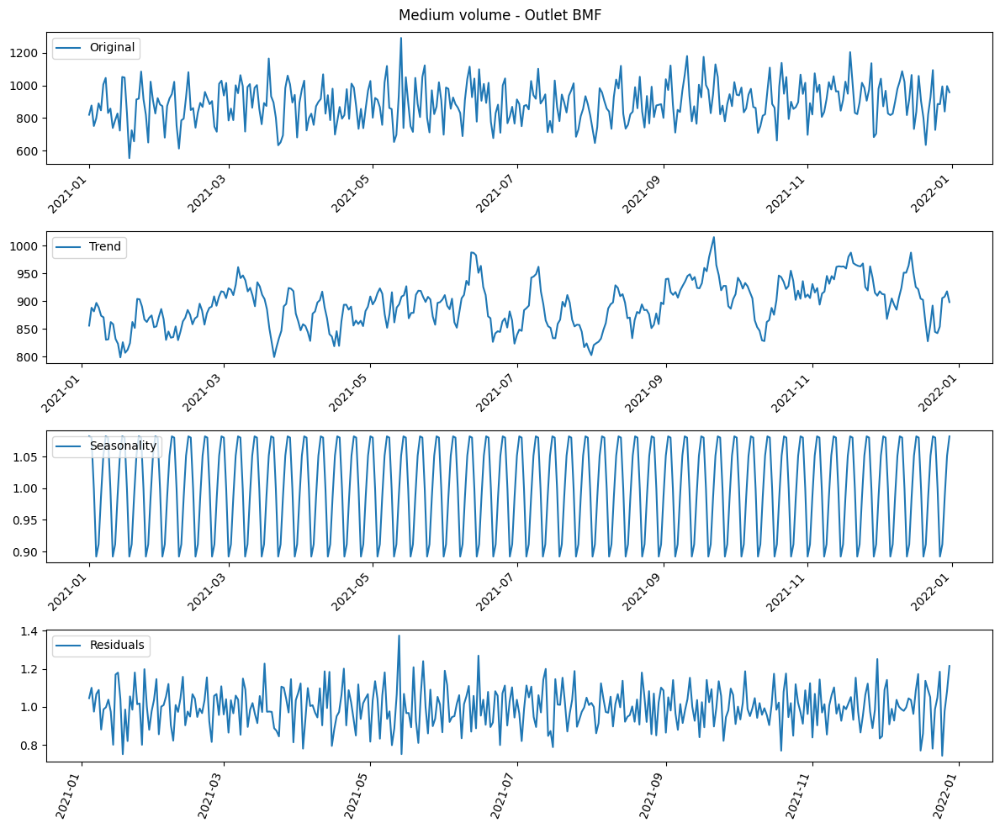

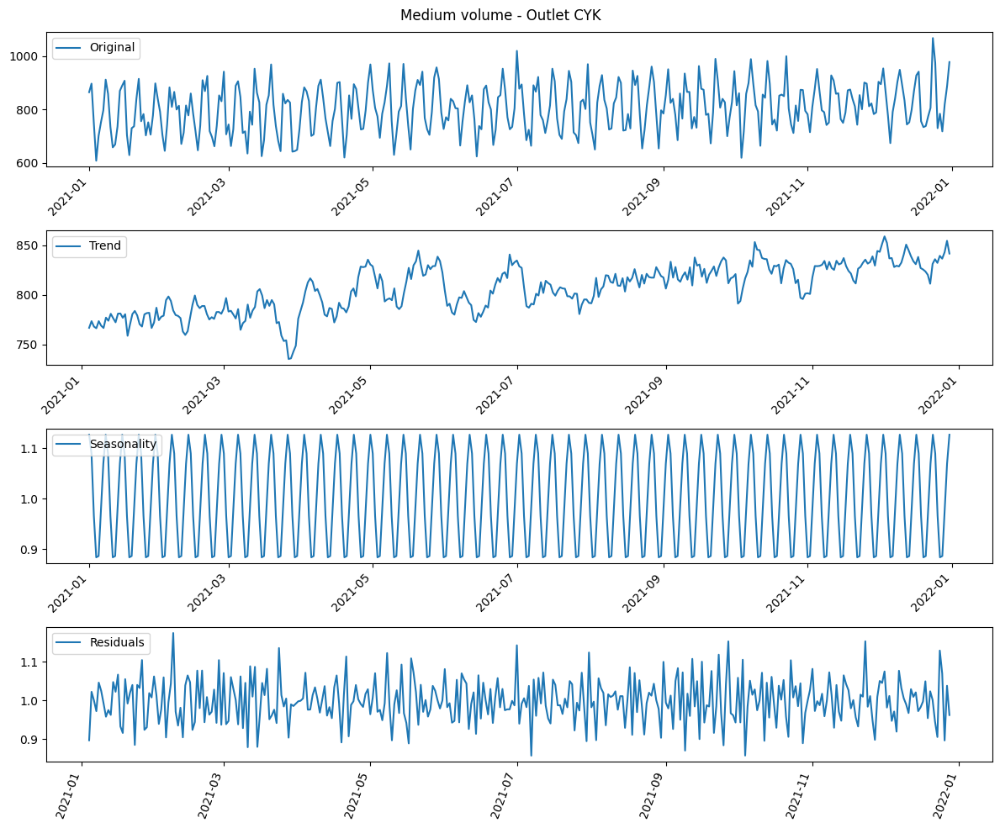

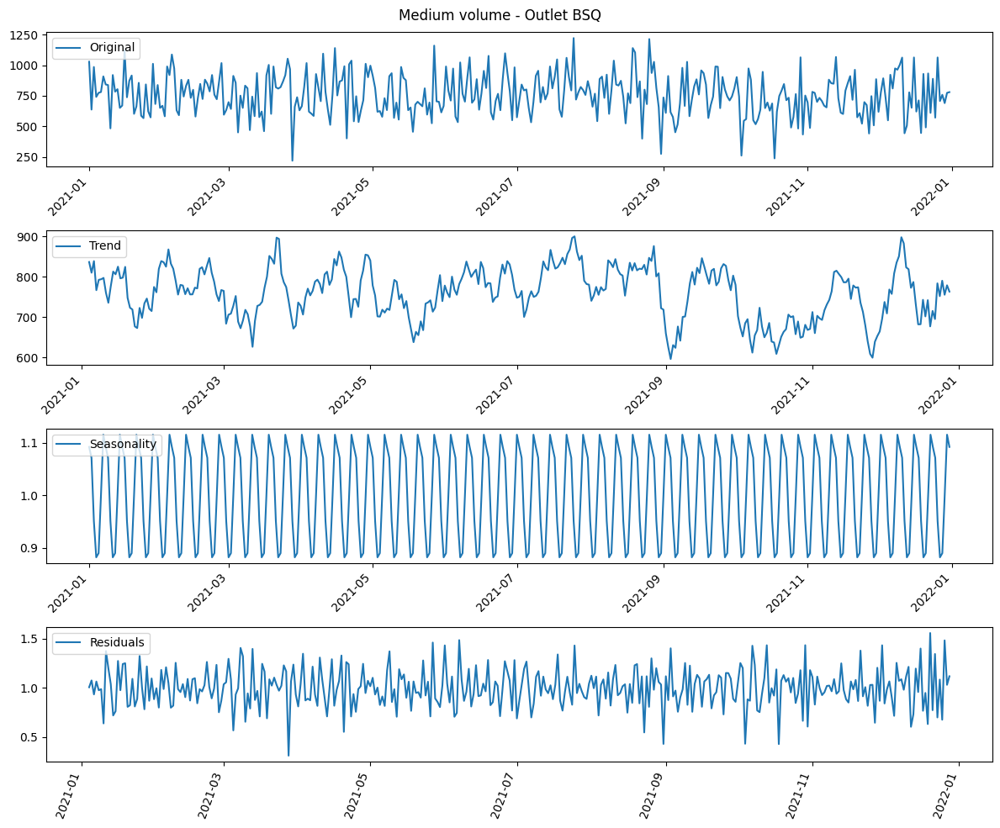

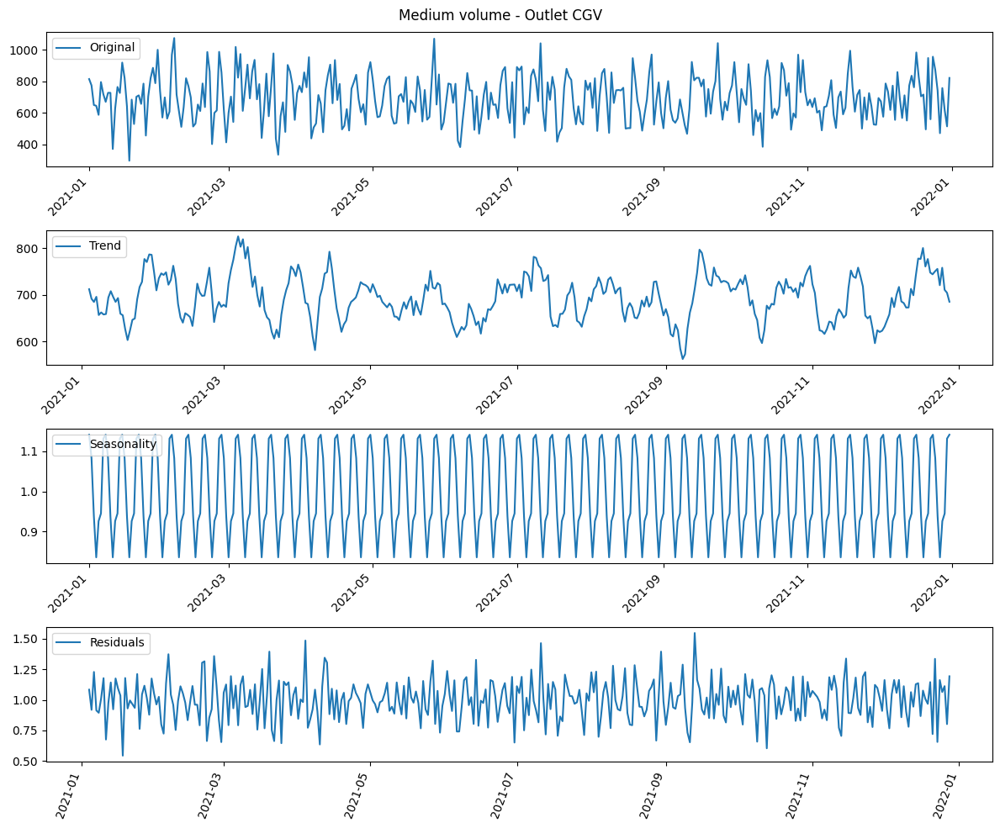

In [274]:
from statsmodels.tsa.seasonal import seasonal_decompose
for name in main_data[medium].columns:
    result = seasonal_decompose(main_data[name], model='multiplicative', period = 7)
    # result.xticks(rotation = 70)
    trend_estimate = result.trend
    seasonal_estimate = result.seasonal
    residual_estimate = result.resid

    fig, axes = plt.subplots(4, 1)
    fig.set_figheight(10)
    fig.set_figwidth(12)

    
    axes[0].plot(main_data[name], label='Original')
    axes[0].legend(loc='upper left');
    axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

    axes[1].plot(trend_estimate, label='Trend')
    axes[1].legend(loc='upper left');
    axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')


    axes[2].plot(seasonal_estimate, label='Seasonality')
    axes[2].legend(loc='upper left');
    axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45, ha='right')


    axes[3].plot(residual_estimate, label='Residuals')
    axes[3].legend(loc='upper left');
    axes[3].set_xticklabels(axes[3].get_xticklabels(), rotation=45, ha='right')



    plt.suptitle('Medium volume - Outlet ' + name)
    plt.xticks(rotation=70)
    plt.tight_layout()
    plt.show()


## High, medium and low volume visitor analysis

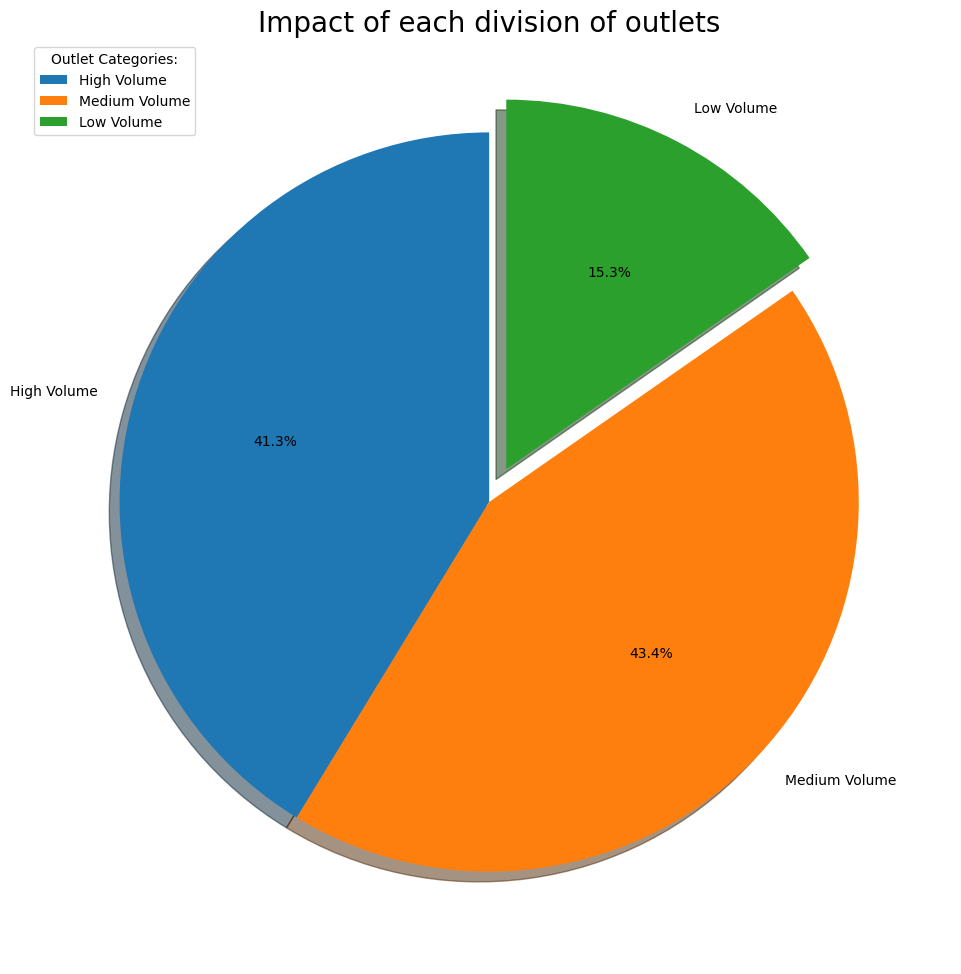

In [275]:
High_Sum, Med_Sum, Low_Sum = (main_data[high].sum()).sum(), (main_data[medium].sum()).sum(), (main_data[low].sum()).sum()

plt.figure(figsize = (25,12))

y = [High_Sum, Med_Sum, Low_Sum]
mylabels = ["High Volume", "Medium Volume", "Low Volume"]
myexplode = [0, 0, 0.1]

plt.pie(y, labels = mylabels , autopct='%1.1f%%', explode = myexplode, shadow = True, startangle = 90)
plt.legend(title = 'Outlet Categories:', loc = 2)
plt.title("Impact of each division of outlets", fontsize = 20)
plt.show() 

## Summary

- The High volume outlets contribute around 41.3% of all the visitors into the outlets with only the three outlets being RAN, RFY & DMN.
- The medium volume outlets contribute 43.4% and followed by low volume outlets with 15.3% of all the visitor into the outlets.

##Auto corelation and inferences

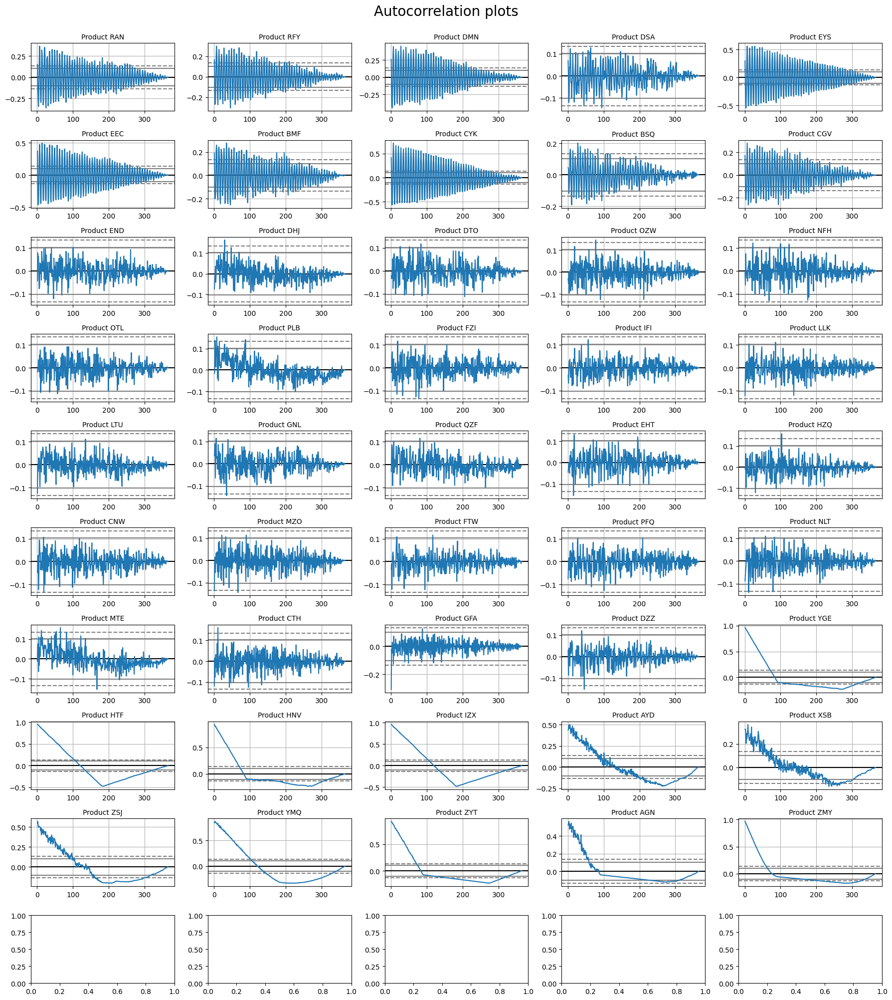

In [276]:
row = 0
col = 0
fig, axes = plt.subplots(figsize=(18, 20), nrows=10, ncols=5)
fig.suptitle('Autocorrelation plots', fontsize=20, position=(0.5, 1.0))
for name in main_data.columns:
    sub = pd.plotting.autocorrelation_plot(main_data[name], axes[row, col])
    sub.set_title('Product ' + name, fontsize=10)
    sub.xaxis.label.set_visible(False)
    sub.yaxis.label.set_visible(False)
    col += 1
    if col == 5:
        row += 1
        col = 0
# plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.tight_layout()
plt.show()


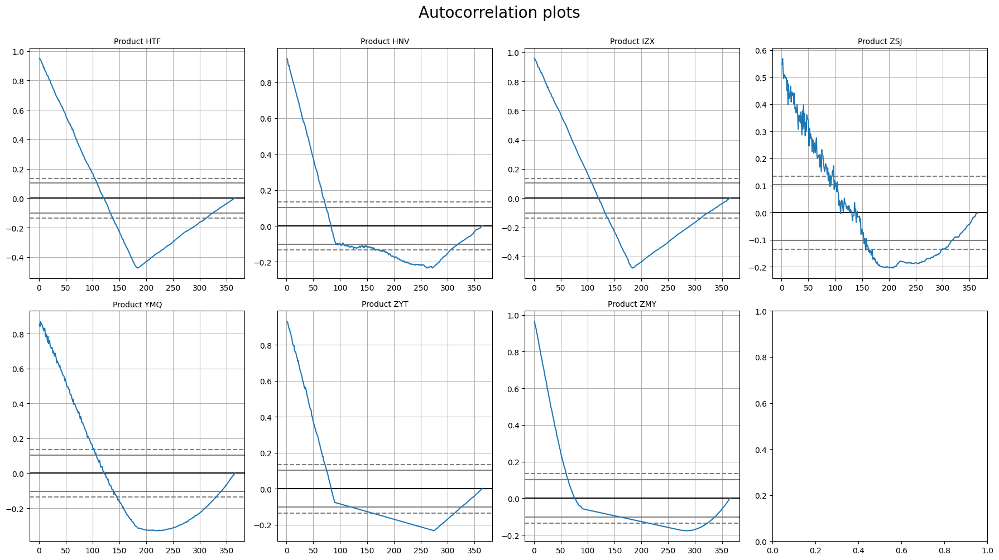

In [277]:
selected = ['HTF', 'HNV', 'IZX', 'ZSJ', 'YMQ', 'ZYT', 'ZMY']
row = 0
col = 0
fig, axes = plt.subplots(figsize=(18, 10), nrows=2, ncols=4)
fig.suptitle('Autocorrelation plots', fontsize=20, position=(0.5, 1.0))
for name in main_data[selected].columns:
    sub = pd.plotting.autocorrelation_plot(main_data[name], axes[row, col])
    sub.set_title('Product ' + name, fontsize=10)
    sub.xaxis.label.set_visible(False)
    sub.yaxis.label.set_visible(False)
    col += 1
    if col == 4:
        row += 1
        col = 0
# plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.tight_layout()
plt.show()

<ipython-input-278-c6a1a0817089>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')
<ipython-input-278-c6a1a0817089>:22: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')
<ipython-input-278-c6a1a0817089>:27: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45, ha='right')
<ipython-input-278-c6a1a0817089>:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[3].set_xticklabels(axes[3].get_xticklabels(), rotation=45, ha='right')


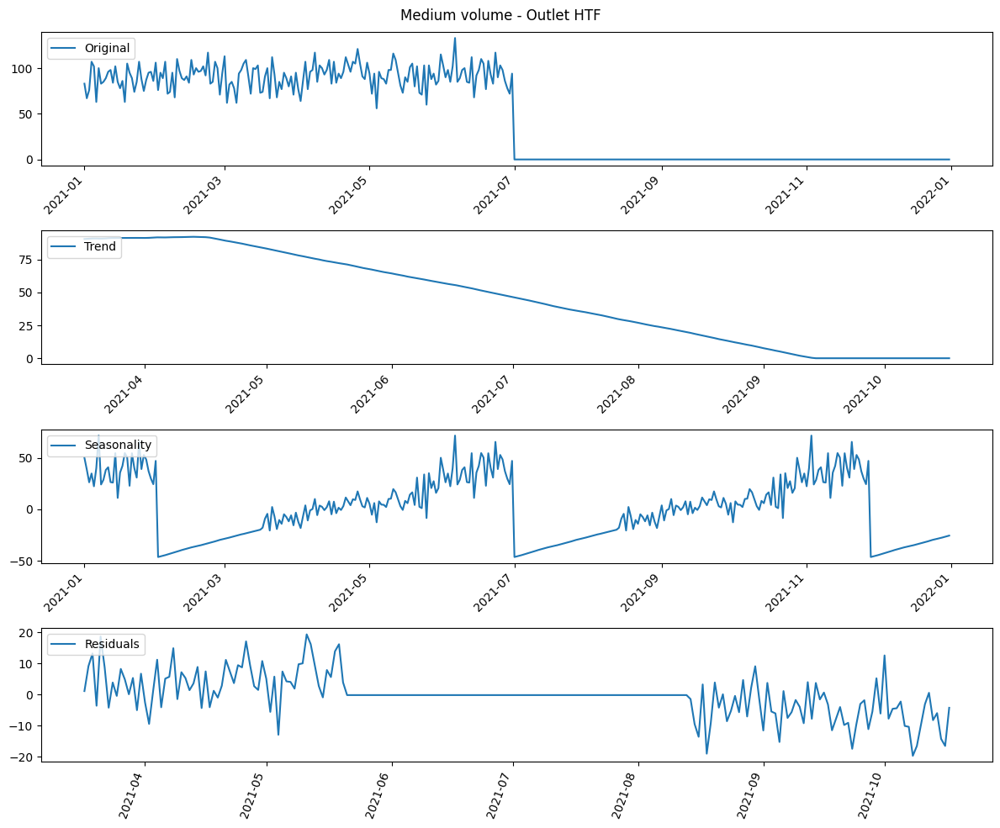

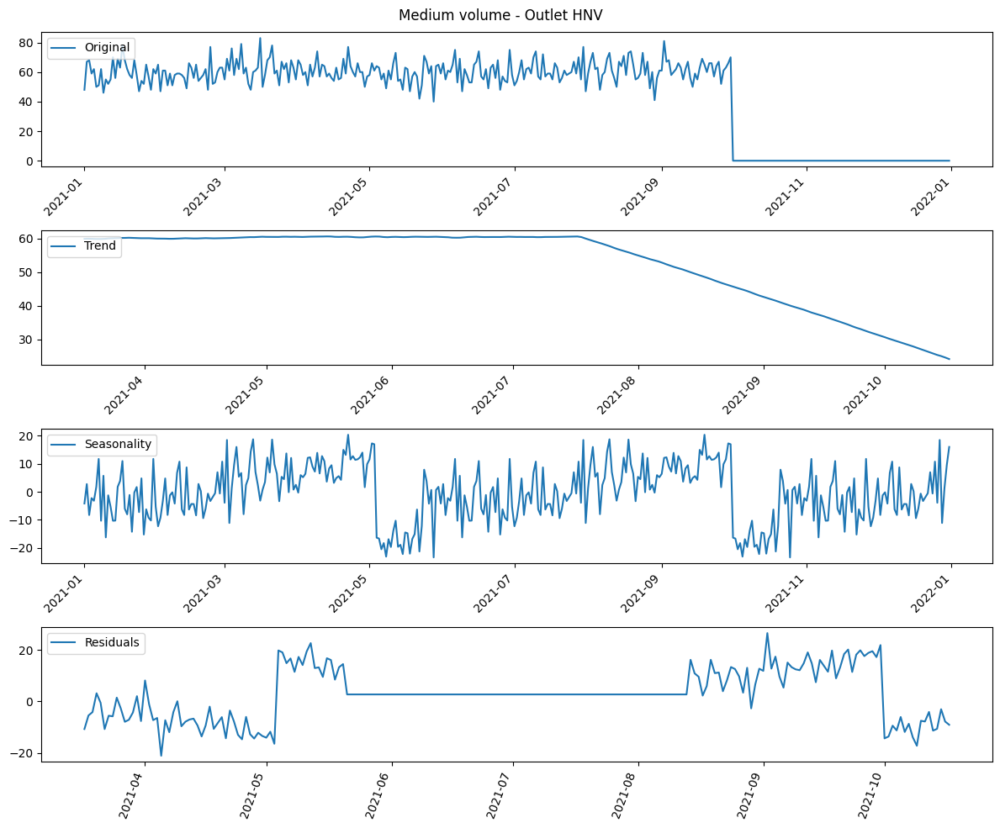

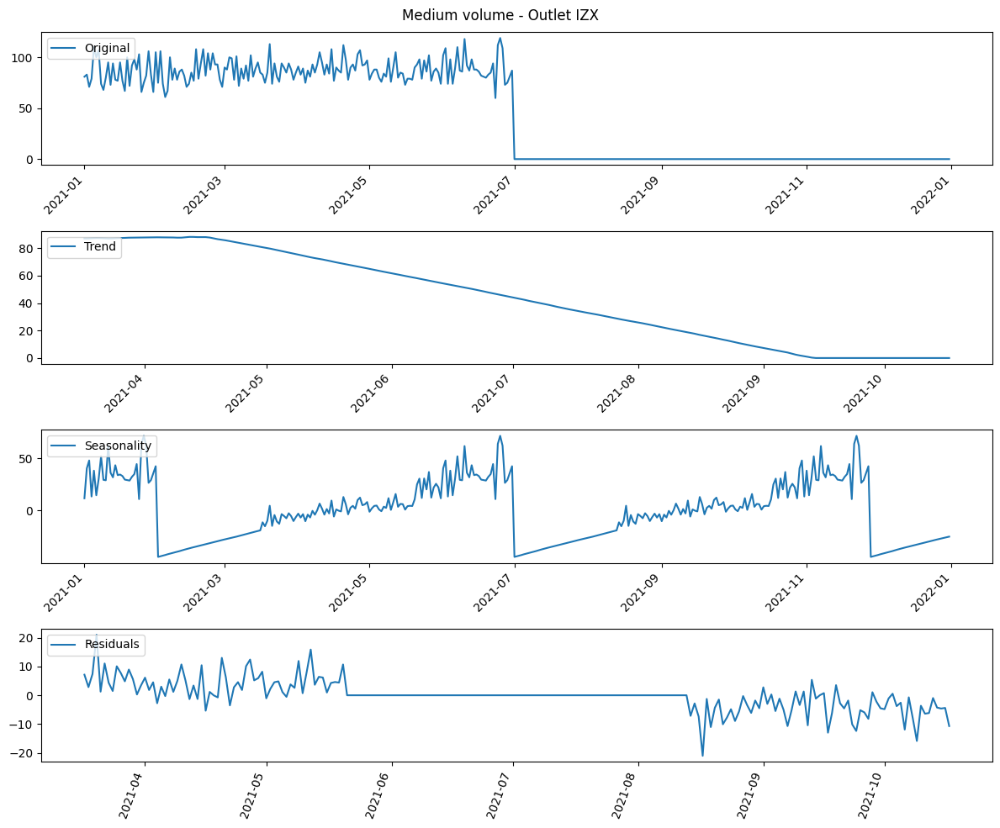

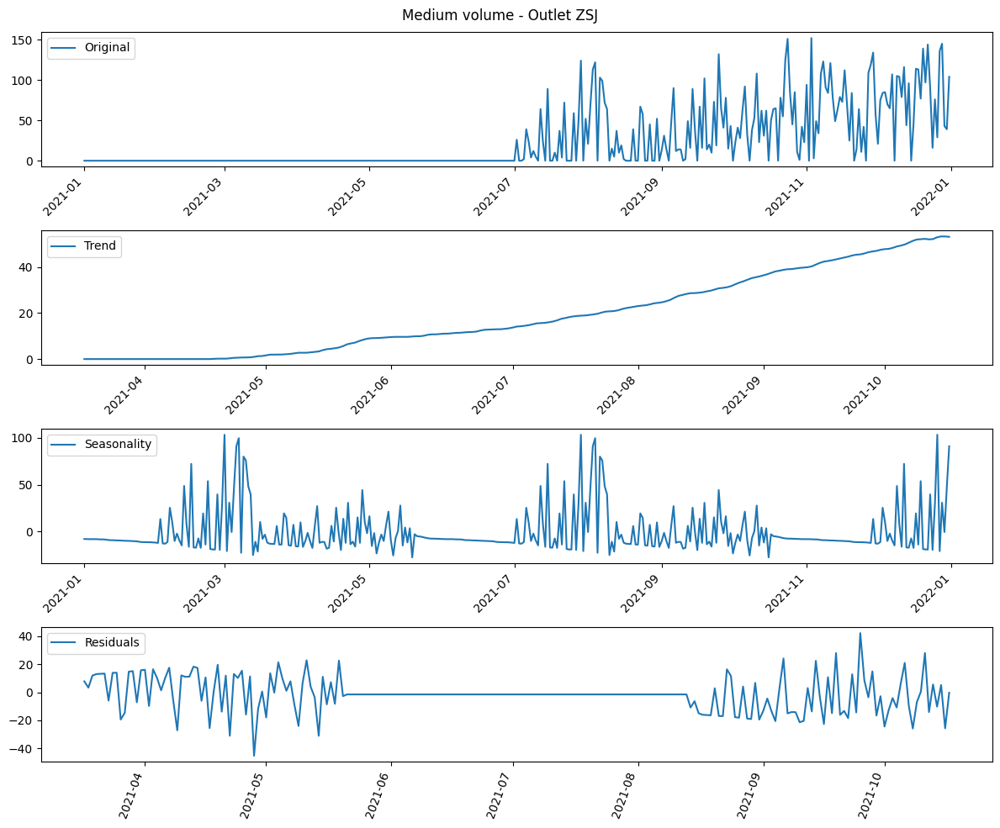

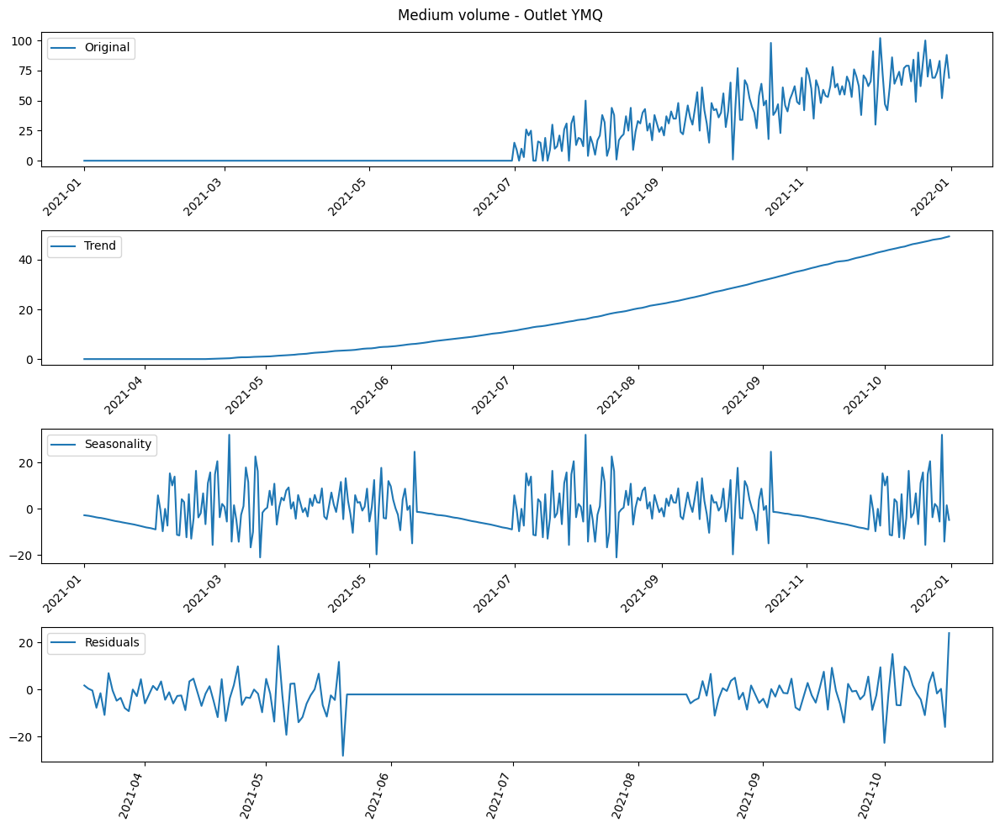

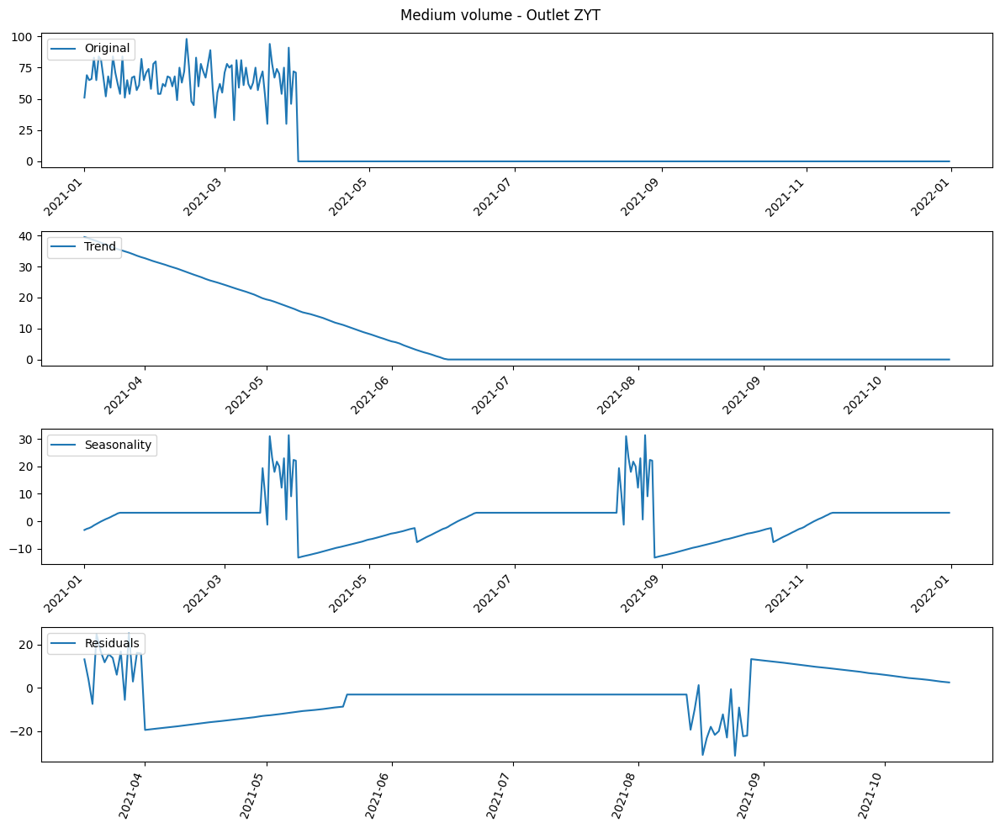

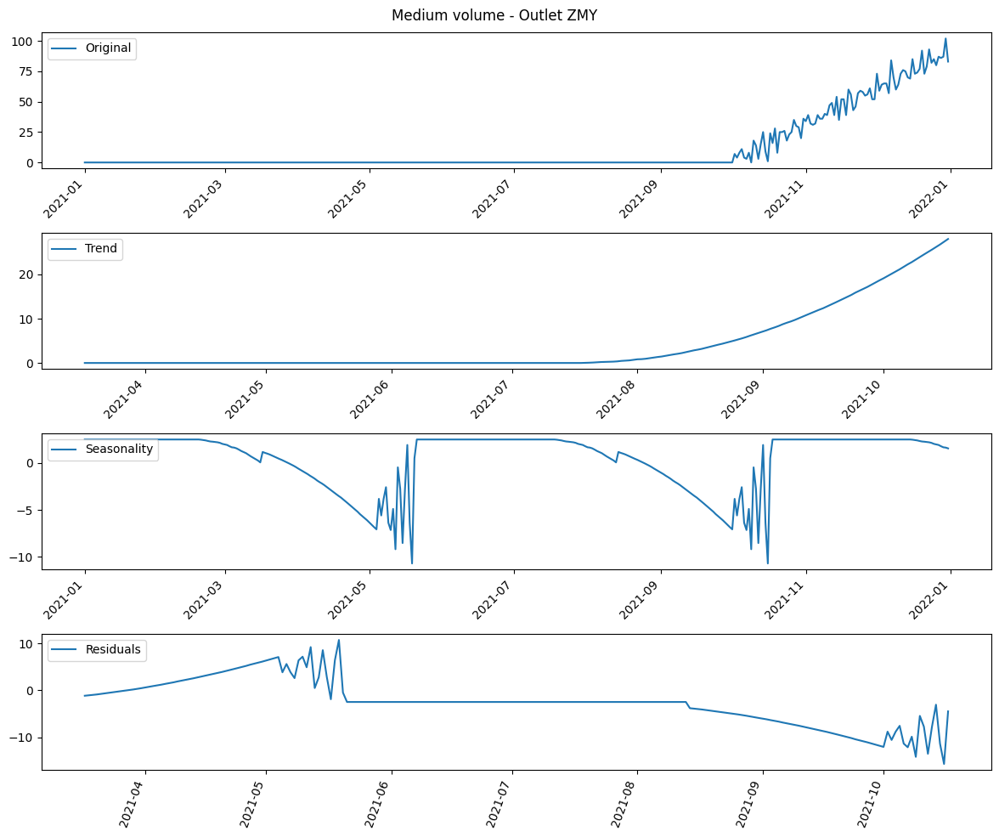

In [278]:
from statsmodels.tsa.seasonal import seasonal_decompose


for name in selected:
    result = seasonal_decompose(main_data[name], model='additive', period=150)

    trend_estimate = result.trend
    seasonal_estimate = result.seasonal
    residual_estimate = result.resid

    fig, axes = plt.subplots(4, 1)
    fig.set_figheight(10)
    fig.set_figwidth(12)

    
    axes[0].plot(main_data[name], label='Original')
    axes[0].legend(loc='upper left');
    axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

    axes[1].plot(trend_estimate, label='Trend')
    axes[1].legend(loc='upper left');
    axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')


    axes[2].plot(seasonal_estimate, label='Seasonality')
    axes[2].legend(loc='upper left');
    axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45, ha='right')


    axes[3].plot(residual_estimate, label='Residuals')
    axes[3].legend(loc='upper left');
    axes[3].set_xticklabels(axes[3].get_xticklabels(), rotation=45, ha='right')



    plt.suptitle('Medium volume - Outlet ' + name)
    plt.xticks(rotation=70)
    plt.tight_layout()
    plt.show()



### Inferences 
- There is a strong trends updwards and downwards in the selected outlets.
- Some seems to come to a zero visitor state and some move from a zero visitor state to some visitor state

In [279]:
def get_line_plot(volume, window_size, date_range):
    if volume == 'high':
        selected = high
    elif volume == 'medium':
        selected = medium
    elif volume == 'low':
        selected = Level1
    elif volume == 'moderately low':
        selected = Level2 
    else:
        selected = Level3

    temp_df = main_data[selected] # restrict to selected products
    temp_df = temp_df.rolling(window=window_size).mean() # calculate rolling average
    temp_df = temp_df.loc[pd.to_datetime(date_range[0]) : pd.to_datetime(date_range[1])] # restrict to date range

    return temp_df.hvplot.line(frame_height = 800, frame_width=1200, grid=True, title = f"{volume.capitalize()} outlets visits per {window_size} days")

In [280]:
time_title = '## Time-Series'

volumes = ['high', 'medium', 'low', 'moderately low', 'very low']

volume = pn.widgets.Select(name='Volume', options=volumes, 
                           width=200, margin=(0, 25, 5, 10))
day_avg = pn.widgets.IntSlider(name='Day average', value=7, start=1, 
                               end=30, width=200, margin=(0, 25, 5, 10))
time_date_range = pn.widgets.DateRangeSlider(name='Dates', width=230,
                                        value=(main_data.index[0], main_data.index[-1]),
                                        start=main_data.index[0], end=main_data.index[-1], 
                                        margin=(0, 25, 5, 10))

time_row = pn.Row(
    pn.Column(time_title, volume, day_avg, time_date_range),
    get_line_plot(volume.value, day_avg.value, time_date_range.value)
)

def update_time_row(event):
    time_row[1].object = get_line_plot(volume.value, day_avg.value, time_date_range.value)

volume.param.watch(update_time_row, 'value')
day_avg.param.watch(update_time_row, 'value')
time_date_range.param.watch(update_time_row, 'value')

time_row.servable()

Row
    [0] Column
        [0] Markdown(str)
        [1] Select(margin=(0, 25, 5, 10), name='Volume', options=['high', 'medium', ...], value='high', width=200)
        [2] IntSlider(end=30, margin=(0, 25, 5, 10), name='Day average', start=1, value=7, width=200)
        [3] DateRangeSlider(end=Timestamp('2021-12-31 0..., margin=(0, 25, 5, 10), name='Dates', start=Timestamp('2021-01-01 0..., value=(Timestamp('2021-01-01 00:..., value_end=Timestamp('2021-12-31 0..., value_start=Timestamp('2021-01-01 0..., width=230)
    [1] HoloViews(NdOverlay, sizing_mode='fixed')

## Summary dataset creation and analysis


In [281]:
marketing = pd.read_csv("https://tinyurl.com/ChrisCoDV/001284166/OutletMarketing.csv") # the total annual spend on local marketing for each outlet
overheads = pd.read_csv("https://tinyurl.com/ChrisCoDV/001284166/OutletOverheads.csv") # the total annual cost of overheads for each outlet
floor_space = pd.read_csv("https://tinyurl.com/ChrisCoDV/001284166/OutletSize.csv") # the size (floor space) in metres squared for each outlet
staff = pd.read_csv("https://tinyurl.com/ChrisCoDV/001284166/OutletStaff.csv") # the total number of full-time staff employed at each outlet


In [282]:
col_name = ['Daily_Visitors']  # Daily visitors overall count in each outlet.

daily_visitors = pd.DataFrame(main_data.sum(),columns = col_name)
daily_visitors.index.name = 'Id'

df = pd.merge(pd.merge(pd.merge(pd.merge(daily_visitors, marketing,on=['Id']),overheads, on=['Id']), floor_space,on=['Id']),staff,on=['Id'])
df.set_index(['Id'],inplace = True)
df.head()

,Daily_Visitors,Marketing (£),Overheads (£),Size (msq),Staff
Id,,,,,
RAN,748898,85000,32000,7347,49
RFY,701487,60000,43000,2322,15
DMN,664032,71000,71000,6036,38
DSA,378716,44000,58000,3146,18
EYS,358638,40000,16000,2945,26


In [283]:
print('Getting the shape the data:')
print('____________________________')

df.shape

Getting the shape the data:
____________________________


(45, 5)

In [284]:
print('Getting the statistical information about the data:')
print('___________________________________________________')
print(df.describe())

Getting the statistical information about the data:
___________________________________________________
       Daily_Visitors  Marketing (£)  Overheads (£)  Size (msq)      Staff
count       45.000000      45.000000      45.000000     45.0000  45.000000
mean    113805.000000   12155.555556   53711.111111    821.0000   5.977778
std     193582.087848   20189.956499   23764.586164   1561.1249  10.445723
min       4240.000000    1000.000000   13000.000000     15.0000   1.000000
25%      22131.000000    2000.000000   33000.000000    106.0000   1.000000
50%      26559.000000    3000.000000   53000.000000    175.0000   2.000000
75%      34138.000000    4000.000000   70000.000000    263.0000   3.000000
max     748898.000000   85000.000000   96000.000000   7347.0000  49.000000


In [285]:
df.isna().sum()

Daily_Visitors    0
Marketing (£)     0
Overheads (£)     0
Size (msq)        0
Staff             0
dtype: int64

In [286]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 45 entries, RAN to ZMY
Data columns (total 5 columns):
 #   Column          Non-Null Count  Dtype
---  ------          --------------  -----
 0   Daily_Visitors  45 non-null     int64
 1   Marketing (£)   45 non-null     int64
 2   Overheads (£)   45 non-null     int64
 3   Size (msq)      45 non-null     int64
 4   Staff           45 non-null     int64
dtypes: int64(5)
memory usage: 2.1+ KB


## Inferences from basic steps

- The dataset has 5 columns.
- The dataset has the infromation of a complete year visitors of each outlet with details of the outlets.
- This data is regarding the outltets visited on the various days from January 2021 to December 2021 with details on floor space, maketing information, overheads and total number of staff.
- From the statistical information there are no outlets with any coloumn with zero or null values.


## Exploratoring the data

In [287]:
df1 = df.sort_values(by="Marketing (£)", ascending = False)


In [288]:
def get_correlation_plots(product_x, product_y):
    return df.hvplot.scatter(frame_height=300, frame_width=300,
                             x=product_x, y=product_y,
                             title=product_x + ' vs ' + product_y,
                             size=10, padding=0.1) +\
           df.corr().hvplot.heatmap(frame_height=300, frame_width=300,
                                    title='Attribute correlations',
                                    rot=90, cmap = "coolwarm"
                                   ).opts(invert_yaxis=True, clim=(-1, 1))

### Correlation:

In [289]:
correlation_title = '## Correlations'

product_x = pn.widgets.Select(name='x-axis', options=list(df.columns), width=200)
product_y = pn.widgets.Select(name='y-axis', options=list(df.columns), width=200)

correlation_row = pn.Row(
    pn.Column(correlation_title, product_x, product_y),
    get_correlation_plots(product_x.value, product_y.value)
)

def update_correlation_row(event):
    correlation_row[1].object = get_correlation_plots(product_x.value, product_y.value)

product_x.param.watch(update_correlation_row, 'value')
product_y.param.watch(update_correlation_row, 'value')

correlation_row.servable()

Row
    [0] Column
        [0] Markdown(str)
        [1] Select(name='x-axis', options=['Daily_Visitors', ...], value='Daily_Visitors', width=200)
        [2] Select(name='y-axis', options=['Daily_Visitors', ...], value='Daily_Visitors', width=200)
    [1] HoloViews(Layout)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
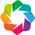

:Layout
   .Scatter.I   :Scatter   [Size (msq)]   (Staff)
   .Scatter.II  :Scatter   [Marketing (£)]   (Size (msq))
   .Scatter.III :Scatter   [Size (msq)]   (Daily_Visitors)
   .Scatter.IV  :Scatter   [Marketing (£)]   (Staff)
   .Scatter.V   :Scatter   [Marketing (£)]   (Daily_Visitors)

In [290]:
# Coloumns are 'Daily_Visitors', 'Marketing (£)', 'Overheads (£)', 'Size (msq)', 'Staff'


plot = df.hvplot.scatter(
    frame_height=300, frame_width=300,
    x='Size (msq)', y='Staff', title='Size (msq) vs Staff', 
    size=20
) + \
df.hvplot.scatter(
    frame_height=300, frame_width=300,
    x='Marketing (£)', y='Size (msq)', title='Marketing (£) vs Size (msq)',
     size=20
) + \
df.hvplot.scatter(
    frame_height=300, frame_width=300,
    x='Size (msq)', y='Daily_Visitors', title='Size (msq) vs Daily_Visitors',
     size=20
)+ \
df.hvplot.scatter(
    frame_height=300, frame_width=300,
    x='Marketing (£)', y='Staff', title='Marketing (£) vs Staff',
     size=20
) + \
df.hvplot.scatter(
    frame_height=300, frame_width=300,
    x='Marketing (£)', y='Daily_Visitors', title='Marketing (£) vs Daily_Visitors',
     size=20
)
hv.extension('bokeh')
plot


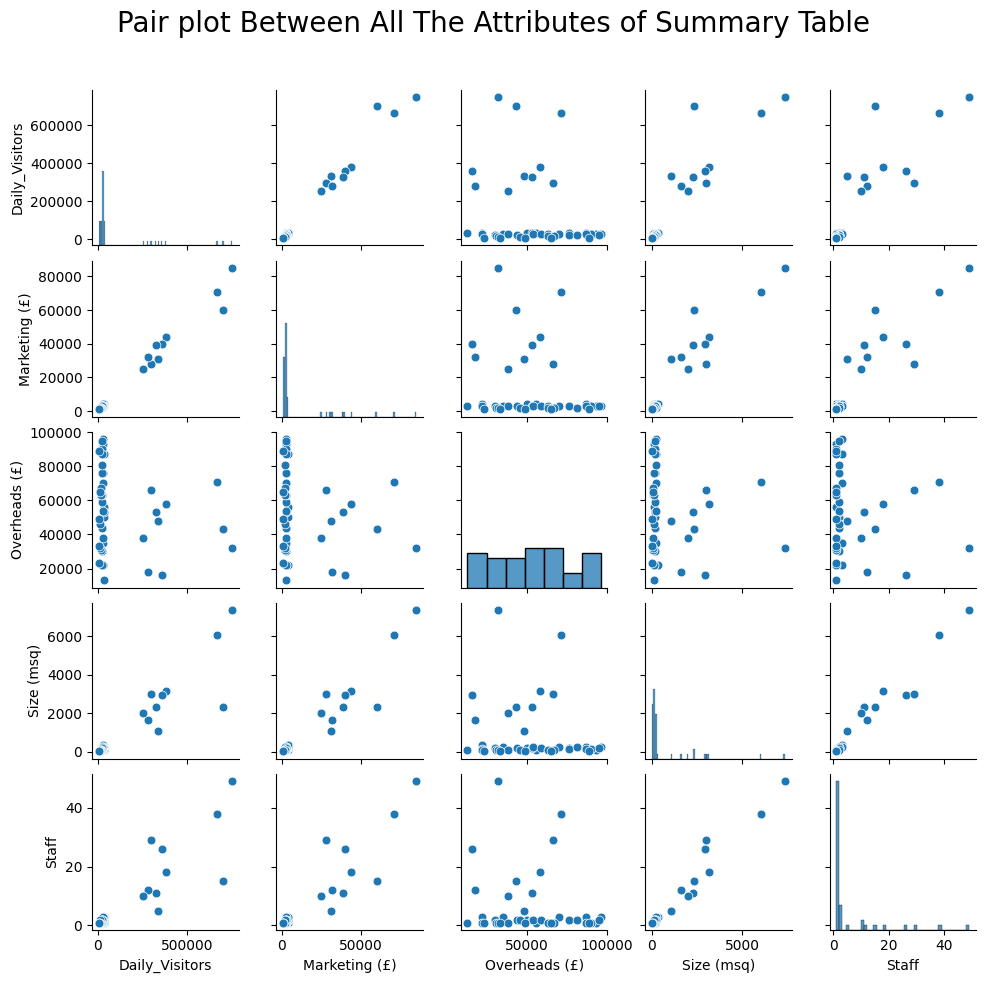

In [293]:
sns.pairplot(df, height=2, plot_kws={'s': 40})
plt.subplots_adjust(top=0.9)
plt.suptitle('Pair plot Between All The Attributes of Summary Table', fontsize = 20)
plt.show()

## Inferences 
- The total number of visitors is strong positively corelated with marketing(0.99), floor_space(0.92) and staff(0.88)
- The only factor with no amount actual corelation with any is oveheads as it is seemed to have mostly not much corelation.
- Marketing seems to have the highest corelation of 0.99 with the total number of visitors.

## Close examination 

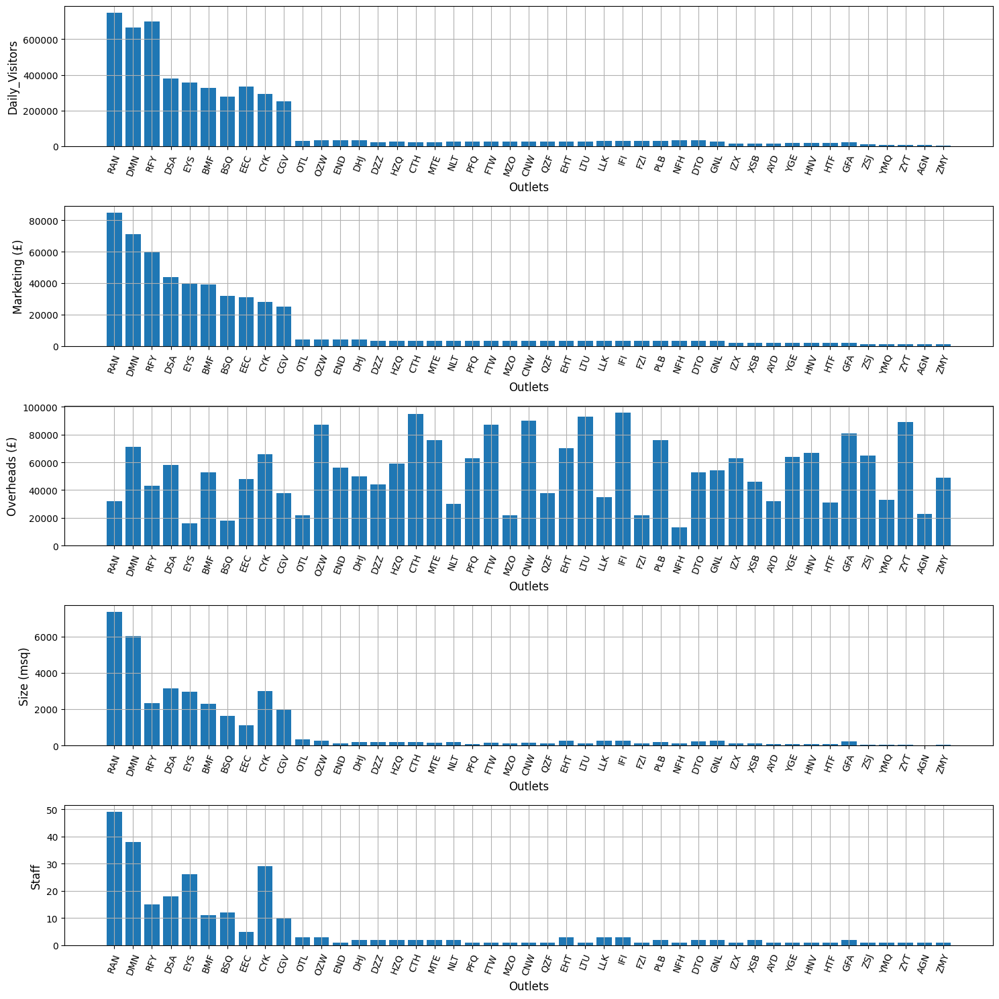

In [294]:
plt.figure(figsize=(15, 15))
counter = 1
x_pos = np.arange(len(df1.index))
for attribute in df1:
    sub = plt.subplot(5, 1, counter)
    sub.bar(x_pos, df1[attribute], align='center')
    sub.set_xticks([])
    sub.set_xticks(x_pos)
    sub.set_xticklabels(df1.index)
    sub.set_xlabel('Outlets', fontsize=12)
    sub.set_ylabel(attribute, fontsize=12)
    plt.xticks(rotation=70)
    plt.grid()
    counter += 1
    
plt.tight_layout()
plt.show()

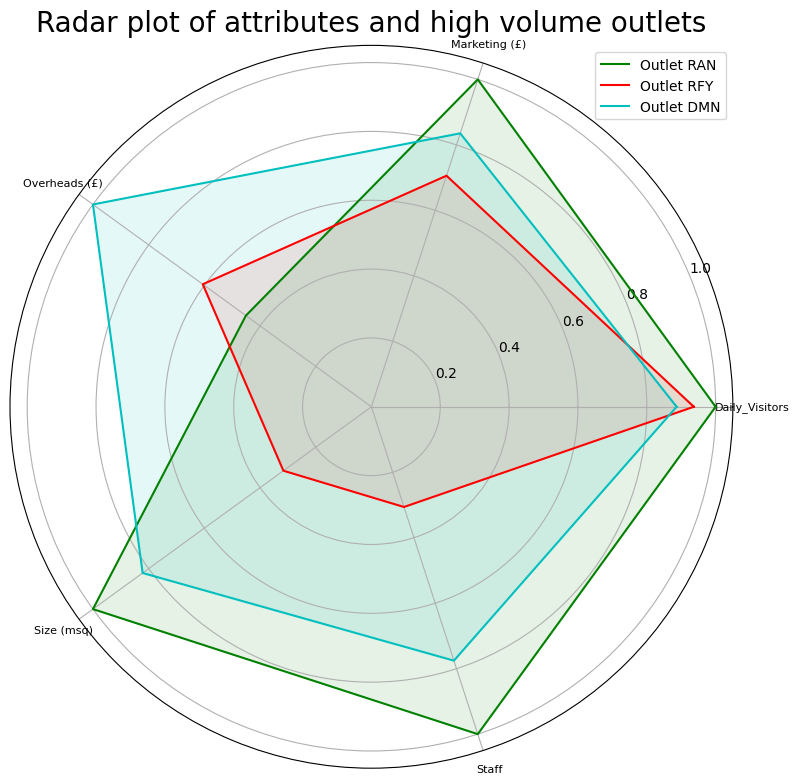

In [296]:
normalised_data = df / df.loc[high].max()

n_attributes = len(normalised_data.columns)
angles = [n / float(n_attributes) * 2 * np.pi for n in range(n_attributes + 1)]

plt.figure(figsize=(12, 8))
colours = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'w']
counter = 1
sub = plt.subplot(1, 1, counter, polar=True)
for name in df.loc[high].index:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    values += values[:1]
    sub.plot(angles, values, colours[counter % len(colours)],  label='Outlet ' + name)
    sub.fill(angles, values, colours[counter % len(colours)],  alpha=0.1)
    sub.set_ylim(ymax=1.05)
    sub.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    sub.set_xticks(angles[0:-1])
    sub.set_xticklabels(normalised_data.columns, fontsize=8)
    counter += 1
plt.title("Radar plot of attributes and high volume outlets", fontsize=20)
plt.legend(loc=1)
plt.tight_layout()
plt.show()

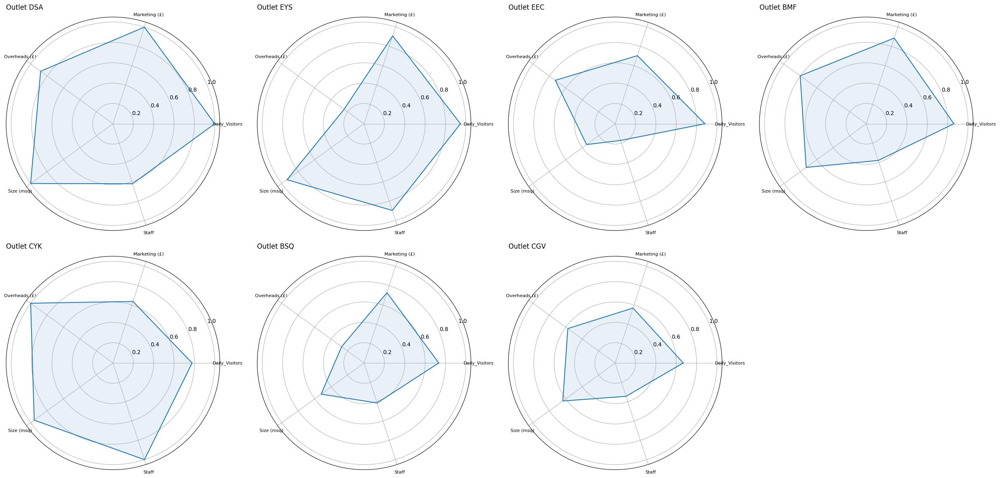

In [292]:
normalised_data = df / df.loc[medium].max()

n_attributes = len(normalised_data.columns)
angles = [n / float(n_attributes) * 2 * np.pi for n in range(n_attributes + 1)]

plt.figure(figsize=(25, 12))
counter = 1
for name in df.loc[medium].index:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    values += values[:1]
    sub = plt.subplot(2, 4, counter, polar=True)
    sub.plot(angles, values)
    sub.fill(angles, values, alpha=0.1)
    sub.set_ylim(ymax=1.05)
    sub.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    sub.set_xticks(angles[0:-1])
    sub.set_xticklabels(normalised_data.columns, fontsize=8)
    sub.set_title('Outlet ' + name, fontsize=12, loc='left')
    counter += 1
plt.tight_layout()
plt.show()

## Inferences 
- From bar plot EEC eventhough have less marketing, staff and floor space shows a larger total visit.
- From the spider plot of high total visit volume outlet the marketing, staff and floor space seems to below compared to other high performing outlets but has a high number of visit.
- From sipder plots of medium volume outlets BSQ and EEC has larger volume visits with lesser floor space and marketing.